In [ ]:
# из библиотеки google.colab импортируем класс files
from google.colab import files

# создаем объект этого класса, применяем метод .upload()
uploaded = files.upload()

Saving VisDrone2019-DET-val.zip to VisDrone2019-DET-val.zip


In [ ]:
!unzip "/content/VisDrone2019-DET-val.zip" -d "/content/dataset"

**Генерация fragments.txt**

Поиск фрагментов изображений с визуализацией
Найдено 14 фрагментов и 548 изображений
Обработка...
------------------------------------------------------------


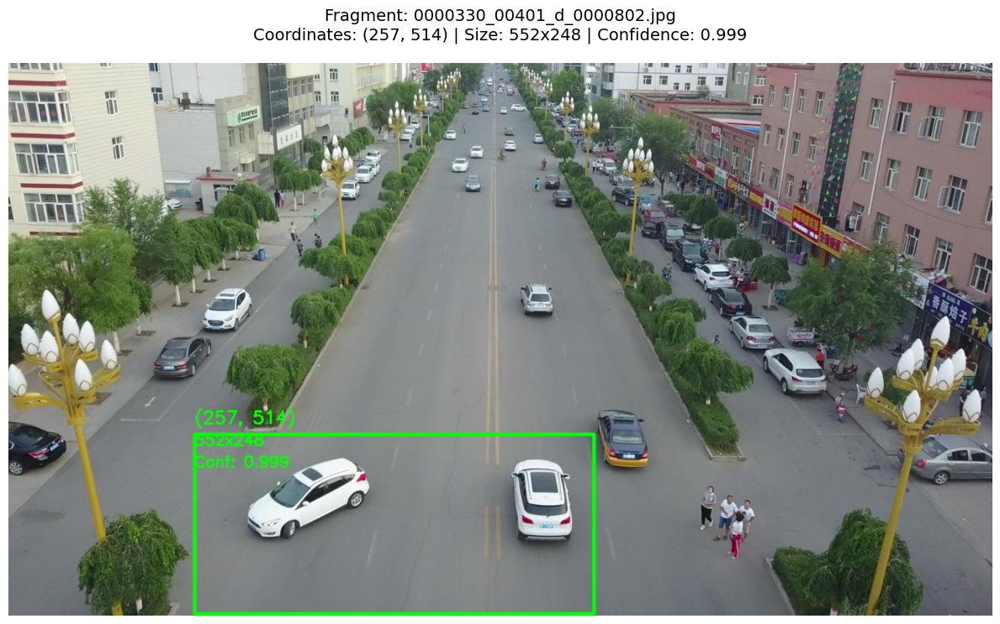

✓ 0000330_00401_d_0000802.jpg: (257, 514) - 552x248 [conf: 0.999]


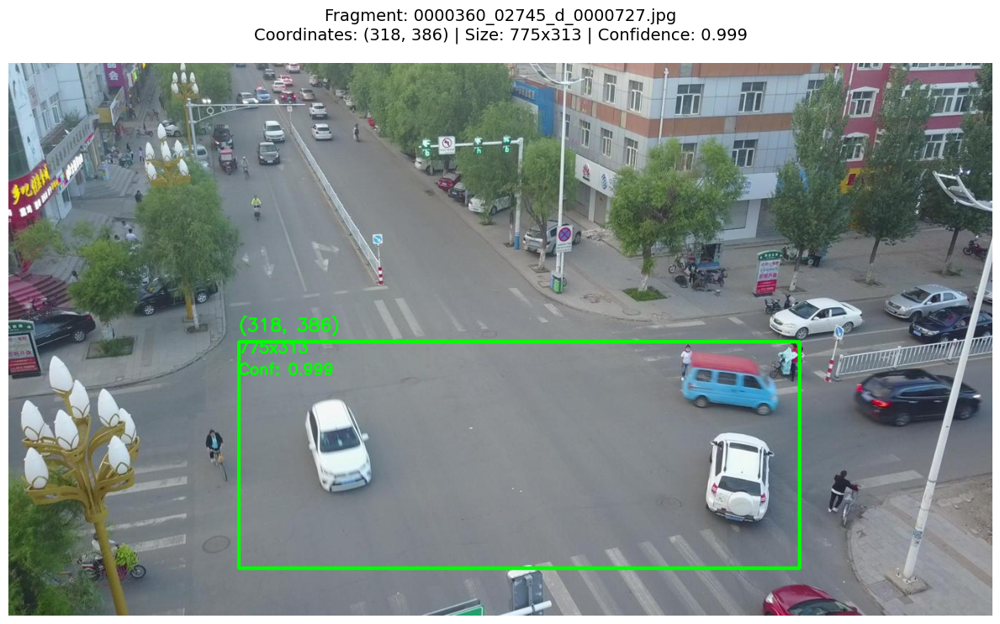

✓ 0000360_02745_d_0000727.jpg: (318, 386) - 775x313 [conf: 0.999]


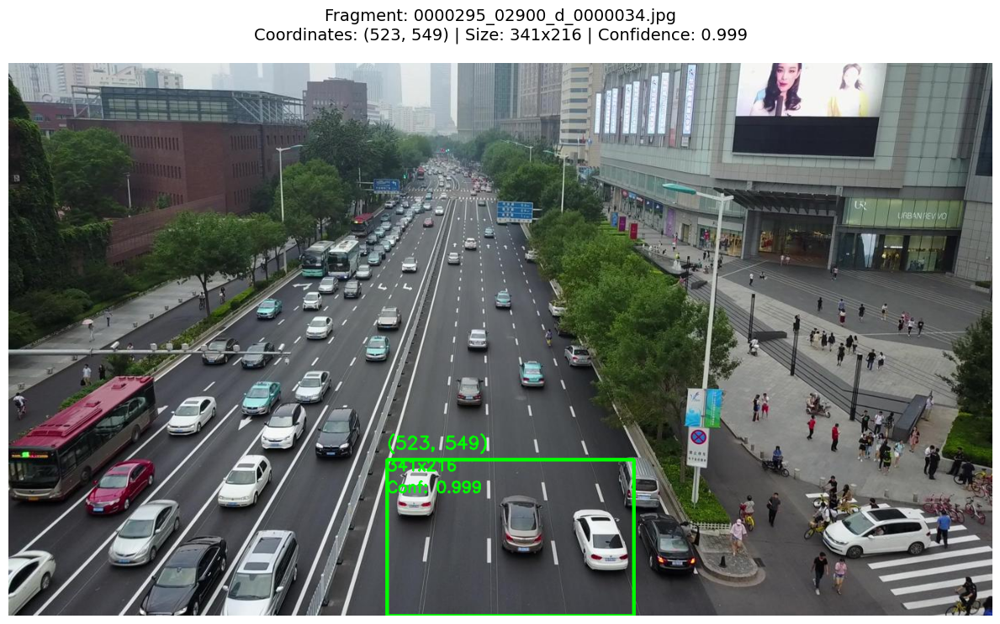

✓ 0000295_02900_d_0000034.jpg: (523, 549) - 341x216 [conf: 0.999]


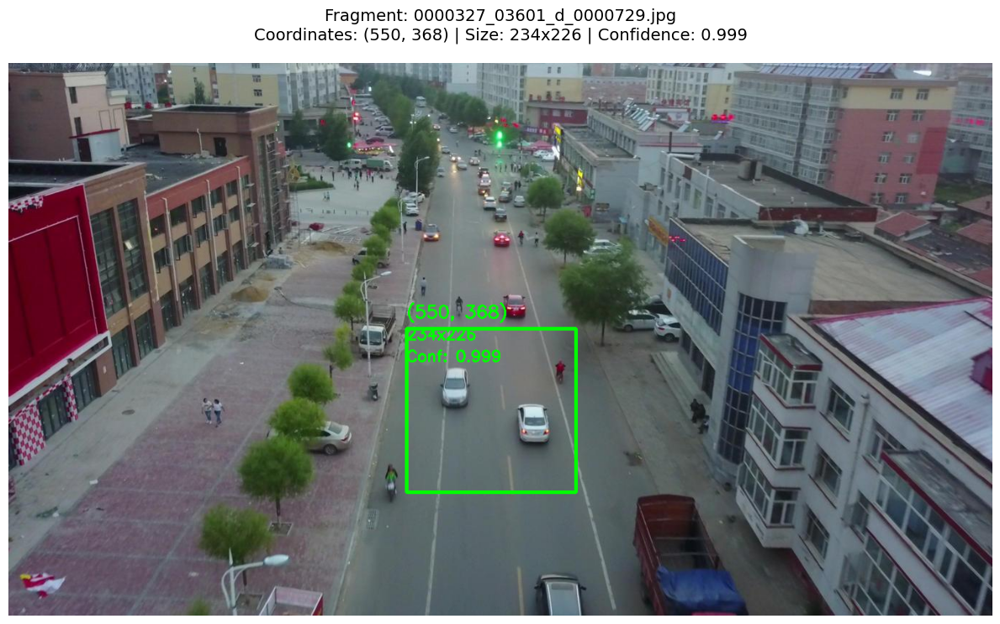

✓ 0000327_03601_d_0000729.jpg: (550, 368) - 234x226 [conf: 0.999]


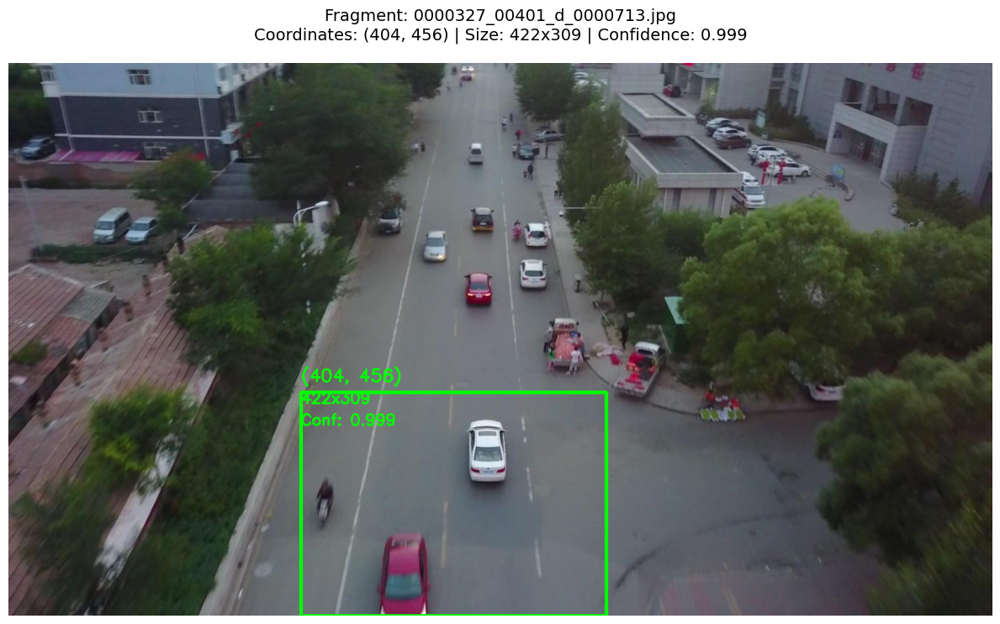

✓ 0000327_00401_d_0000713.jpg: (404, 456) - 422x309 [conf: 0.999]


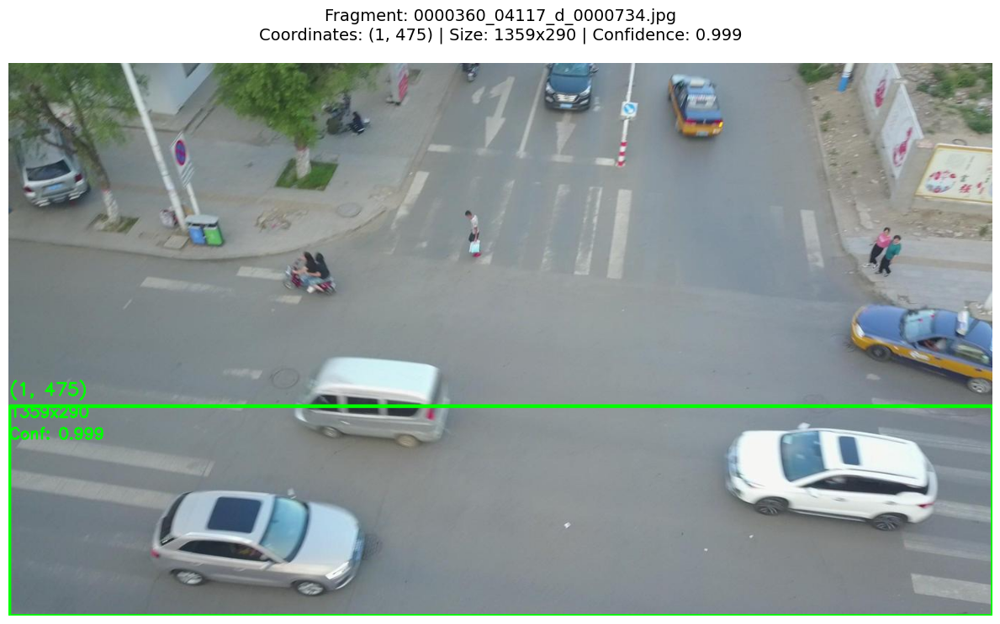

✓ 0000360_04117_d_0000734.jpg: (1, 475) - 1359x290 [conf: 0.999]


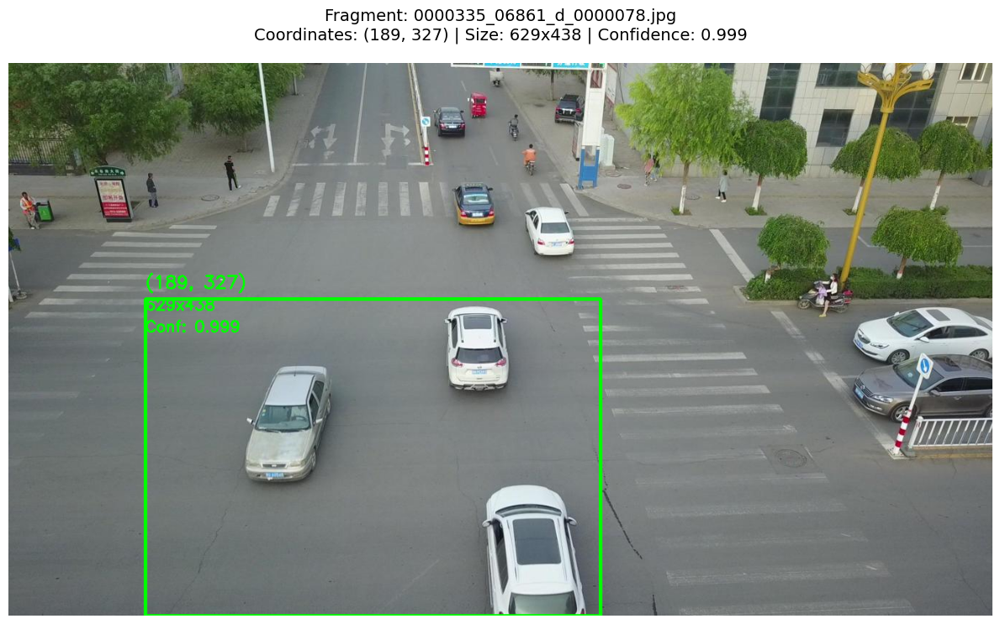

✓ 0000335_06861_d_0000078.jpg: (189, 327) - 629x438 [conf: 0.999]


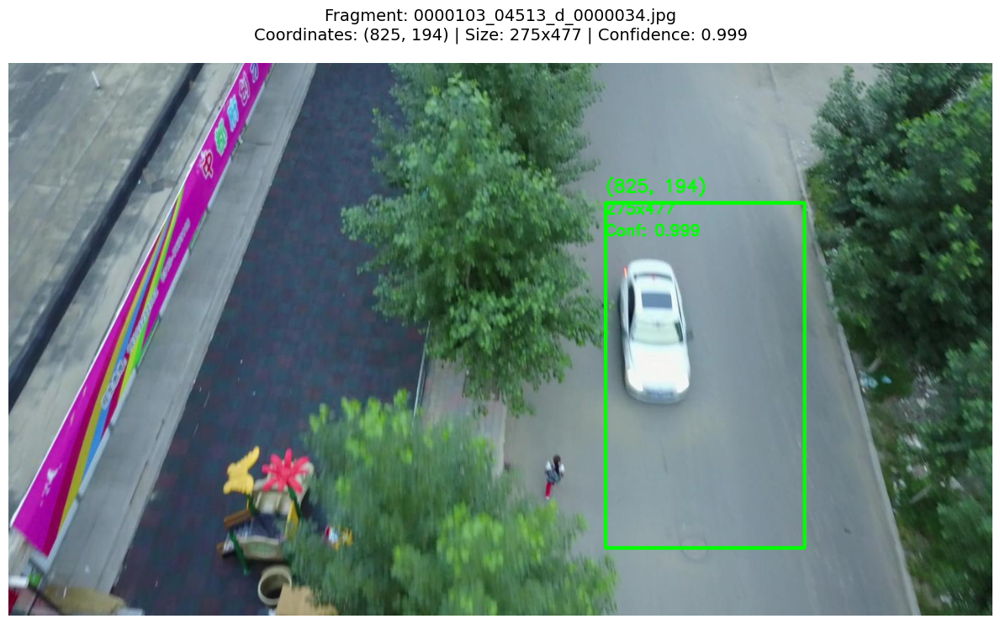

✓ 0000103_04513_d_0000034.jpg: (825, 194) - 275x477 [conf: 0.999]


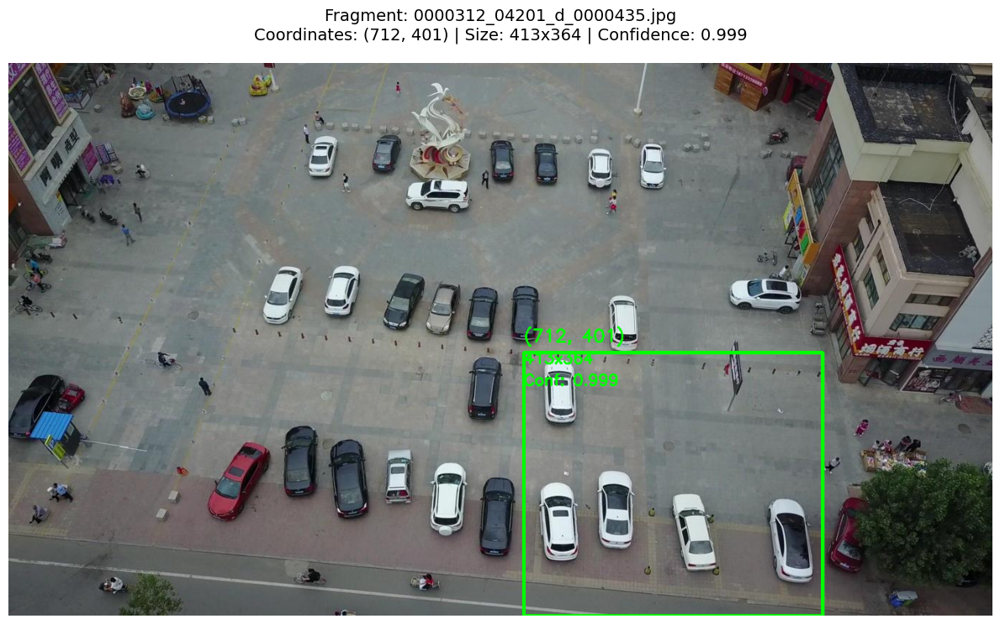

✓ 0000312_04201_d_0000435.jpg: (712, 401) - 413x364 [conf: 0.999]


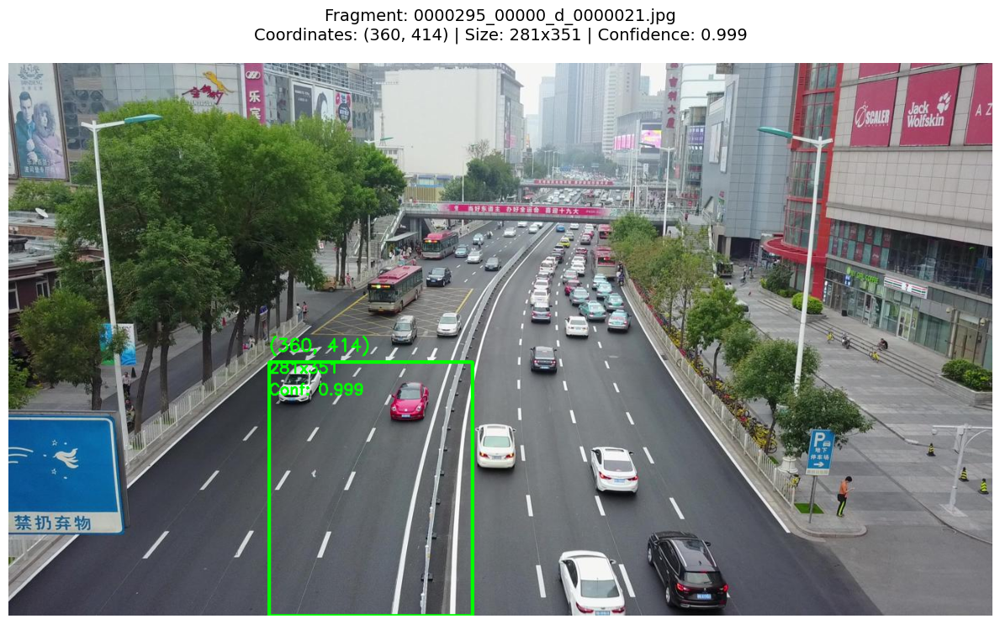

✓ 0000295_00000_d_0000021.jpg: (360, 414) - 281x351 [conf: 0.999]


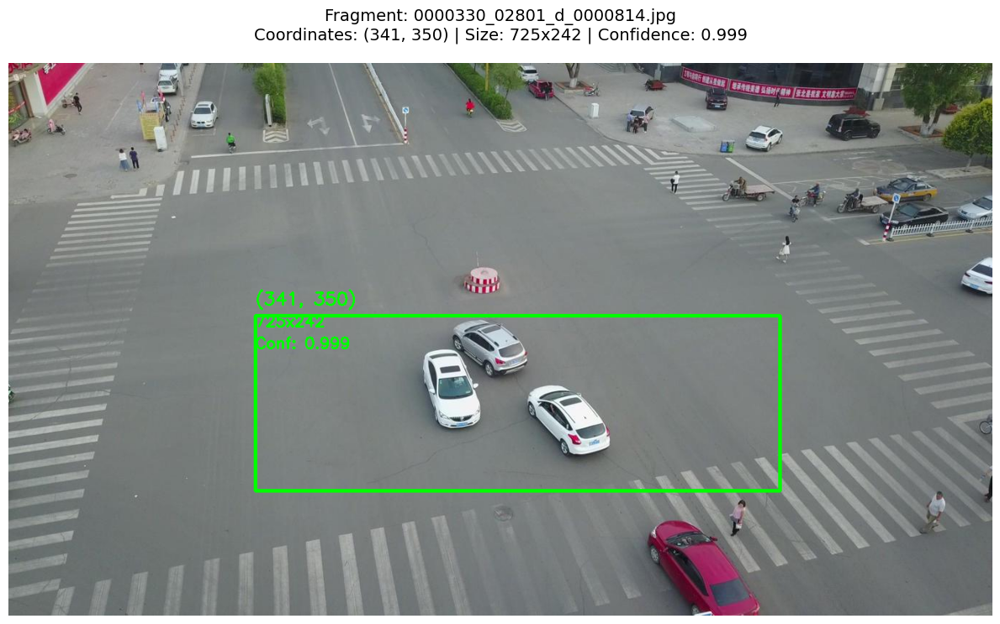

✓ 0000330_02801_d_0000814.jpg: (341, 350) - 725x242 [conf: 0.999]


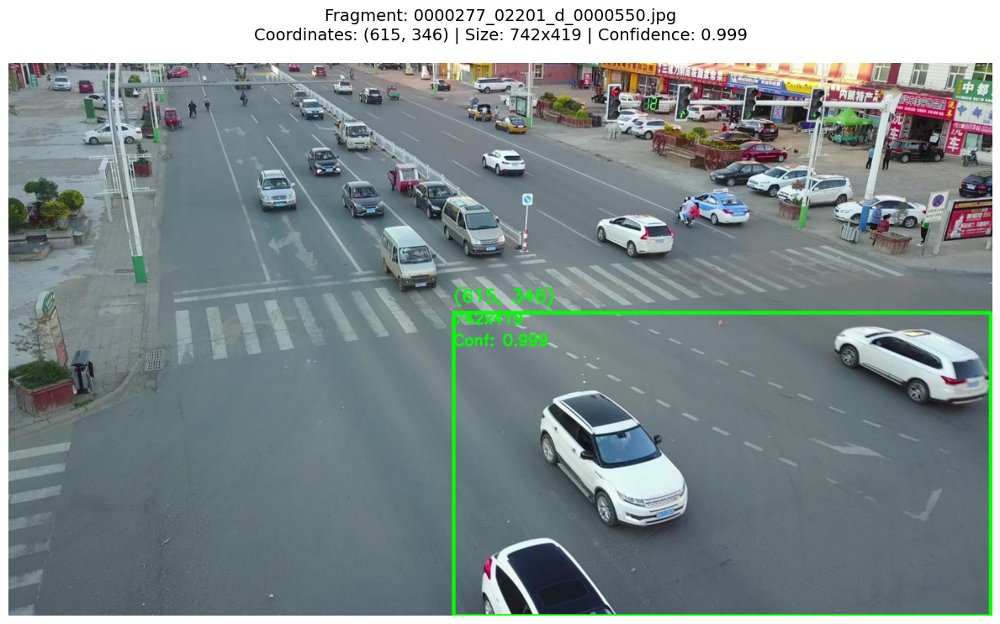

✓ 0000277_02201_d_0000550.jpg: (615, 346) - 742x419 [conf: 0.999]


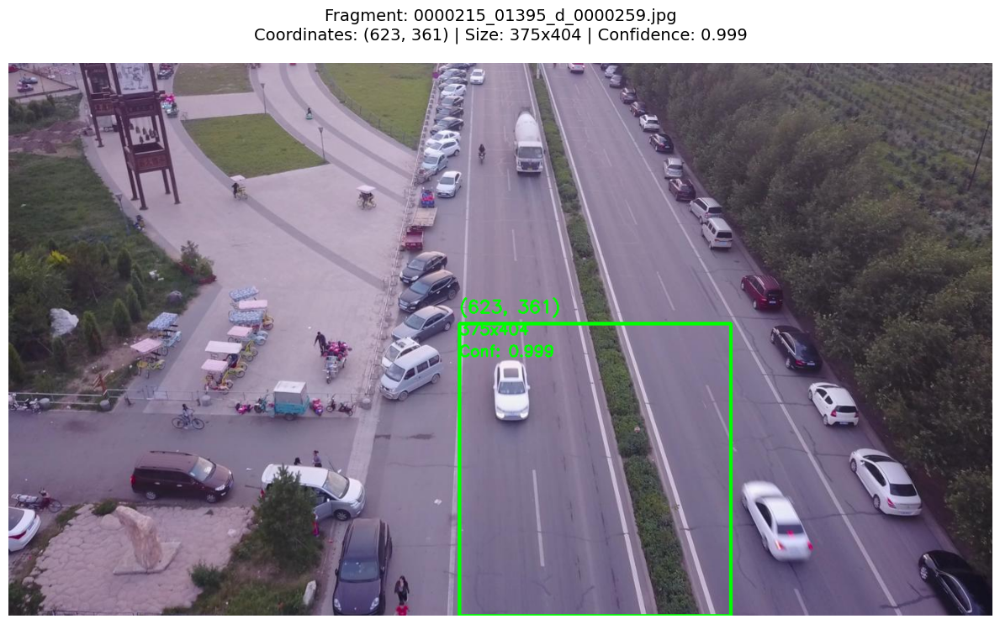

✓ 0000215_01395_d_0000259.jpg: (623, 361) - 375x404 [conf: 0.999]


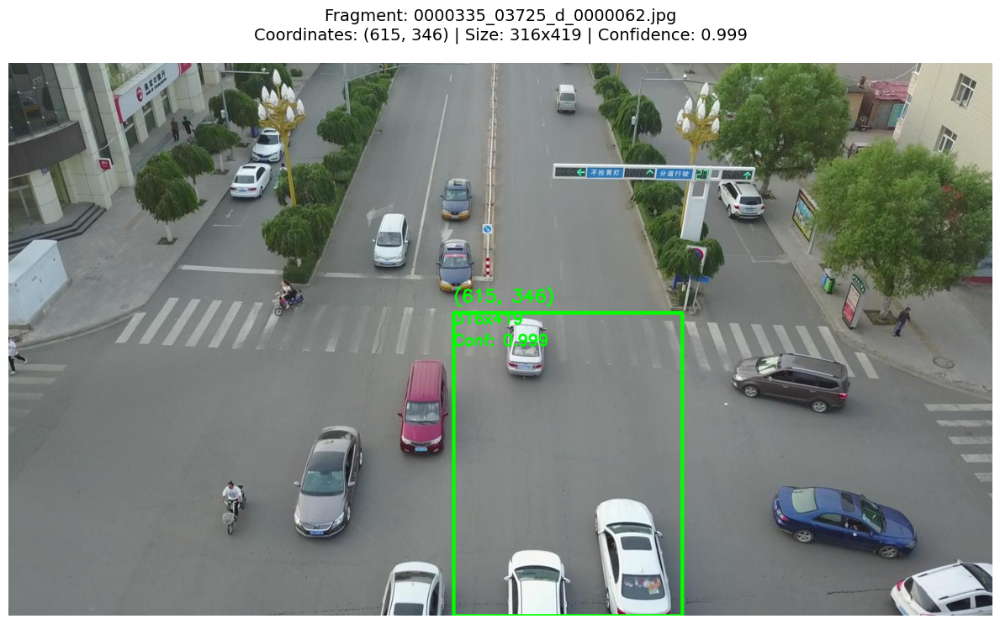

✓ 0000335_03725_d_0000062.jpg: (615, 346) - 316x419 [conf: 0.999]

Готово! Обработано 14 фрагментов.
Результаты сохранены в файл: fragments.txt


In [ ]:
import cv2
import os
import numpy as np
from pathlib import Path
import matplotlib.pyplot as plt

def find_and_display_fragments(images_dir="/content/dataset/VisDrone2019-DET-val/images", fragments_dir="/content/fragments", output_file="fragments.txt"):
    if not os.path.exists(images_dir):
        print(f"Директория {images_dir} не найдена!")
        return

    if not os.path.exists(fragments_dir):
        print(f"Директория {fragments_dir} не найдена!")
        return

    fragment_files = os.listdir(fragments_dir)
    image_files = os.listdir(images_dir)

    print(f"Найдено {len(fragment_files)} фрагментов и {len(image_files)} изображений")
    print("Обработка...")
    print("-" * 60)

    processed_count = 0

    with open(output_file, 'w', encoding='utf-8') as f:
        for fragment_file in fragment_files:
            fragment_path = os.path.join(fragments_dir, fragment_file)

            corresponding_image = None
            corresponding_image_name = None
            for image_file in image_files:
                fragment_name = Path(fragment_file).stem
                image_name = Path(image_file).stem

                if fragment_name == image_name:
                    corresponding_image = os.path.join(images_dir, image_file)
                    corresponding_image_name = image_file
                    break

            if corresponding_image is None:
                print(f"Не найдено соответствующее изображение для фрагмента {fragment_file}")
                continue

            try:
                template = cv2.imread(fragment_path)
                image = cv2.imread(corresponding_image)

                if template is None:
                    print(f"Не удалось загрузить фрагмент {fragment_path}")
                    continue

                if image is None:
                    print(f"Не удалось загрузить изображение {corresponding_image}")
                    continue

                template_height, template_width = template.shape[:2]

                image_height, image_width = image.shape[:2]
                if template_height > image_height or template_width > image_width:
                    print(f"Фрагмент {fragment_file} больше исходного изображения")
                    continue

                result = cv2.matchTemplate(image, template, cv2.TM_CCOEFF_NORMED)
                min_val, max_val, min_loc, max_loc = cv2.minMaxLoc(result)
                top_left = max_loc
                bottom_right = (top_left[0] + template_width, top_left[1] + template_height)


                f.write(f"{corresponding_image_name}, {top_left[0]}, {top_left[1]}, {template_width}, {template_height}\n")
                display_image = image.copy()
                cv2.rectangle(display_image, top_left, bottom_right, (0, 255, 0), 3)
                coord_text = f"({top_left[0]}, {top_left[1]})"
                size_text = f"{template_width}x{template_height}"
                confidence_text = f"Conf: {max_val:.3f}"

                text_y = max(top_left[1] - 15, 25)
                cv2.putText(display_image, coord_text, (top_left[0], text_y),
                           cv2.FONT_HERSHEY_SIMPLEX, 0.8, (0, 255, 0), 2)
                cv2.putText(display_image, size_text, (top_left[0], text_y + 30),
                           cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 255, 0), 2)
                cv2.putText(display_image, confidence_text, (top_left[0], text_y + 60),
                           cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 255, 0), 2)

                display_image_rgb = cv2.cvtColor(display_image, cv2.COLOR_BGR2RGB)

                plt.figure(figsize=(12, 8))
                plt.imshow(display_image_rgb)
                plt.title(f'Fragment: {fragment_file}\nCoordinates: ({top_left[0]}, {top_left[1]}) | Size: {template_width}x{template_height} | Confidence: {max_val:.3f}',
                         fontsize=14, pad=20)
                plt.axis('off')
                plt.tight_layout()
                plt.show()

                print(f"✓ {fragment_file}: ({top_left[0]}, {top_left[1]}) - {template_width}x{template_height} [conf: {max_val:.3f}]")
                processed_count += 1

            except Exception as e:
                print(f"✗ Ошибка при обработке {fragment_file}: {str(e)}")
                continue

    print(f"\nГотово! Обработано {processed_count} фрагментов.")
    print(f"Результаты сохранены в файл: {output_file}")

if __name__ == "__main__":
    print("Поиск фрагментов изображений с визуализацией")
    print("=" * 50)

    find_and_display_fragments()

**Вырезка фрагментов**

In [ ]:
import os
from PIL import Image

images_dir = '/content/dataset/VisDrone2019-DET-val/images'
annotations_dir = '/content/dataset/VisDrone2019-DET-val/annotations'
newimages_dir = '/content/newimages'
newannotations_dir = '/content/newannotations'
frames_file = '/content/fragments.txt'

os.makedirs(newimages_dir, exist_ok=True)
os.makedirs(newannotations_dir, exist_ok=True)

with open(frames_file, 'r') as f:
    for line in f:
        parts = [p.strip() for p in line.strip().split(',')]
        if len(parts) >= 5:
            image_name = parts[0]
            try:
                X = int(parts[1])
                Y = int(parts[2])
                width_crop = int(parts[3])
                height_crop = int(parts[4])
            except ValueError:
                print(f"Некорректные координаты в строке frames.txt: {line.strip()}")
                continue

            if width_crop <= 0 or height_crop <= 0 or X < 0 or Y < 0:
                print(f"Некорректные размеры обрезки для {image_name}: X={X}, Y={Y}, width={width_crop}, height={height_crop}")
                continue

            image_path = os.path.join(images_dir, image_name)
            annotation_path = os.path.join(annotations_dir, os.path.splitext(image_name)[0] + '.txt')
            new_image_path = os.path.join(newimages_dir, image_name)
            new_annotation_path = os.path.join(newannotations_dir, os.path.splitext(image_name)[0] + '.txt')

            if os.path.exists(image_path):
                try:
                    img = Image.open(image_path)
                    cropped_img = img.crop((X, Y, X + width_crop, Y + height_crop))
                    cropped_img.save(new_image_path)
                except Exception as e:
                    print(f"Ошибка при обработке изображения {image_path}: {e}")
                    continue
            else:
                print(f"Изображение не найдено: {image_path}")
                continue

            adjusted_lines = []
            if os.path.exists(annotation_path):
                with open(annotation_path, 'r') as ann_f:
                    for ann_line in ann_f:
                        ann_parts = [p.strip() for p in ann_line.strip().split(',')]
                        if len(ann_parts) >= 6:
                            try:
                                left = int(ann_parts[0])
                                top = int(ann_parts[1])
                                width = int(ann_parts[2])
                                height = int(ann_parts[3])
                                ignored = ann_parts[4]
                                class_label = ann_parts[5]
                                rest = ann_parts[6:] if len(ann_parts) > 6 else []
                            except ValueError:
                                print(f"Некорректная строка аннотации в {annotation_path}: {ann_line.strip()}")
                                continue

                            if class_label == '4':
                                    right = left + width
                                    bottom = top + height
                                    crop_right = X + width_crop
                                    crop_bottom = Y + height_crop
                                    if left < crop_right and right > X and top < crop_bottom and bottom > Y:
                                        intersection_left = max(left, X)
                                        intersection_top = max(top, Y)
                                        intersection_right = min(right, crop_right)
                                        intersection_bottom = min(bottom, crop_bottom)
                                        intersection_width = intersection_right - intersection_left
                                        intersection_height = intersection_bottom - intersection_top
                                        if intersection_width > 0 and intersection_height > 0:
                                            new_left = intersection_left - X
                                            new_top = intersection_top - Y
                                            new_ann_parts = [str(new_left), str(new_top), str(intersection_width), str(intersection_height), ignored, class_label] + rest
                                            adjusted_lines.append(','.join(new_ann_parts) + '\n')

            if adjusted_lines:
                with open(new_annotation_path, 'w') as new_ann_f:
                    new_ann_f.writelines(adjusted_lines)

print("Обработка завершена.")

Обработка завершена.


**Проверка ограничивающих рамок**

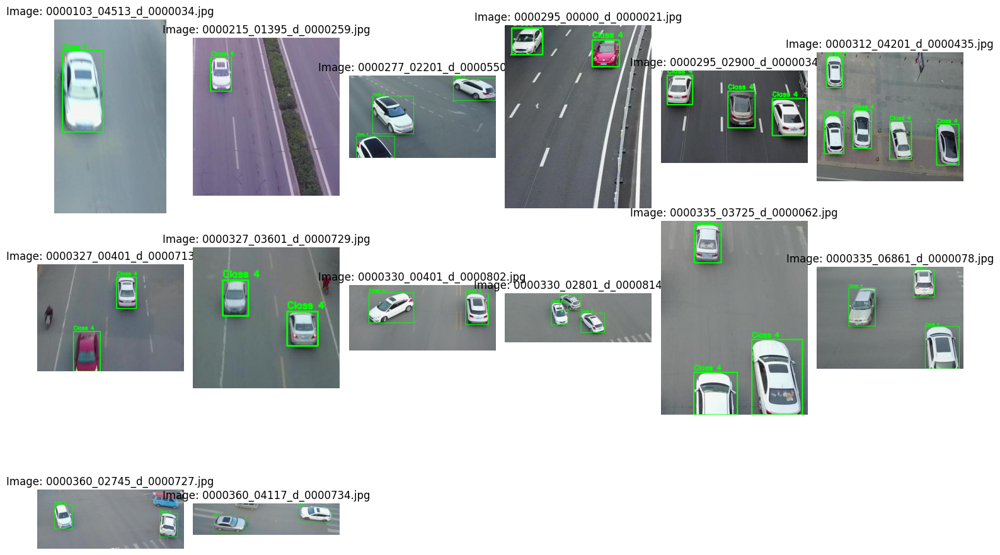

In [ ]:
import cv2
import os
import matplotlib.pyplot as plt
import numpy as np

image_dir = '/content/newimages'
annotation_dir = '/content/newannotations'

if not os.path.exists(image_dir) or not os.path.exists(annotation_dir):
    raise FileNotFoundError("Проверьте пути к директориям images и annotations!")

image_files = [f for f in os.listdir(image_dir) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
image_files.sort()

colors = {
    4: (0, 255, 0),
    'default': (0, 165, 255)
}
font = cv2.FONT_HERSHEY_SIMPLEX
font_scale = 0.5
thickness = 2

def visualize_image(img_path, ann_path):
    image = cv2.imread(img_path)
    if image is None:
        print(f"Ошибка загрузки: {img_path}")
        return

    with open(ann_path, 'r') as f:
        lines = f.readlines()

    for line in lines:
        parts = line.strip().split(',')
        if len(parts) < 5:
            continue

        try:
            x, y, w, h = map(float, parts[:4])
            class_id = int(parts[5])

            x, y, w, h = int(x), int(y), int(w), int(h)

            if w <= 0 or h <= 0:
                continue

            color = colors.get(class_id, colors['default'])
            cv2.rectangle(image, (x, y), (x + w, y + h), color, thickness)
            text = f'Class {class_id}'
            cv2.putText(image, text, (x, y - 5), font, font_scale, color, thickness)

        except Exception as e:
            print(f"Ошибка в строке: {line.strip()} | {e}")
            continue

    return image

plt.figure(figsize=(15, 10))
for i, img_file in enumerate(image_files):
    base_name = os.path.splitext(img_file)[0]
    img_path = os.path.join(image_dir, img_file)
    ann_path = os.path.join(annotation_dir, base_name + '.txt')

    if os.path.exists(ann_path):
        image = visualize_image(img_path, ann_path)
        image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        plt.subplot(3, 6, i + 1)
        plt.imshow(image_rgb)
        plt.title(f'Image: {img_file}')
        plt.axis('off')
    else:
        print(f"Аннотация не найдена: {ann_path}")

plt.tight_layout()
plt.show()

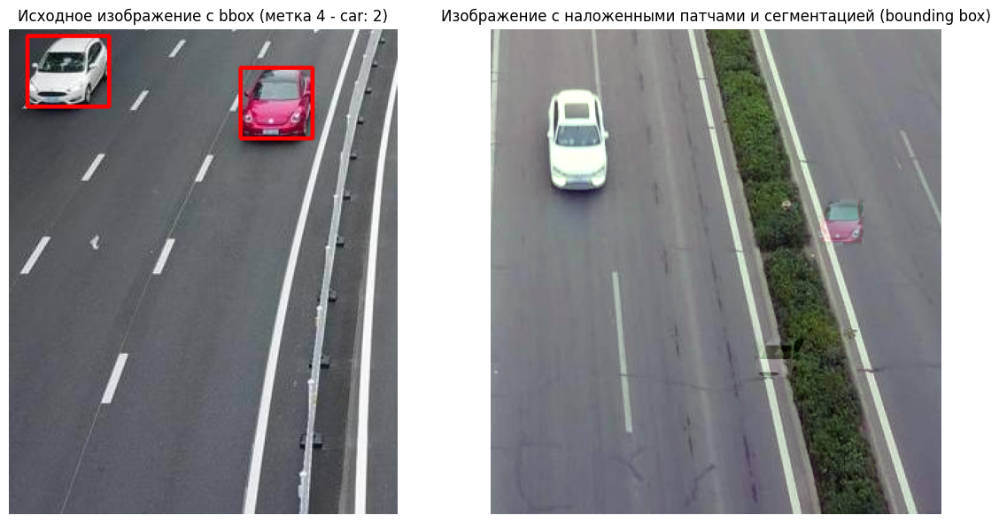




Predicted car at [258, 70, 332, 152], Hu moments: [7.07523602e-04 9.84546077e-08 7.02260896e-13 4.83165268e-14
 3.86611362e-27 9.00433573e-18 8.01649463e-27]


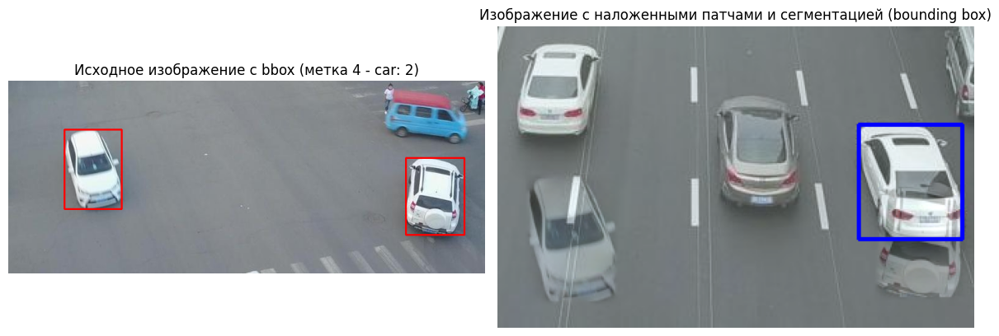




Predicted car at [503, 130, 532, 161], Hu moments: [ 6.96606373e-04  6.09840950e-08  1.86084467e-13  9.53747182e-15
 -1.90669520e-29 -9.77305566e-19 -4.01342743e-28]
Predicted car at [647, 127, 734, 246], Hu moments: [ 7.06552464e-04  4.85454959e-08  1.22041158e-11  4.38089297e-13
 -2.60283892e-25  4.83458147e-17  9.78960202e-25]


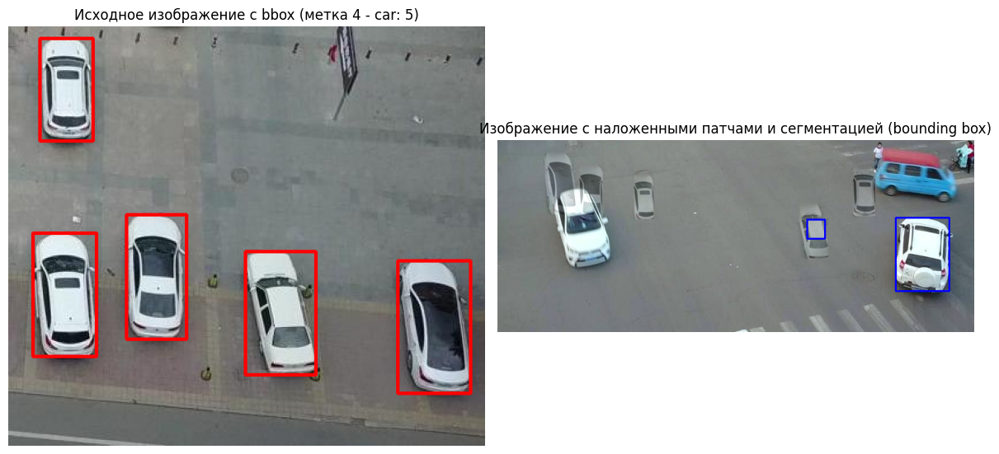




Predicted car at [214, 104, 482, 239], Hu moments: [9.42176321e-04 4.66958096e-07 1.07156808e-11 2.29431546e-12
 9.60902675e-24 9.96298981e-16 6.08933328e-24]
Predicted car at [674, 92, 740, 189], Hu moments: [7.28579479e-04 1.07834357e-07 1.64420859e-11 9.12705116e-13
 2.92842678e-24 2.51141064e-16 1.98126741e-24]
Predicted car at [994, 24, 1283, 161], Hu moments: [9.25831561e-04 4.50843219e-07 4.30384214e-12 6.69014994e-13
 5.48733168e-25 1.12115613e-16 9.93794594e-25]


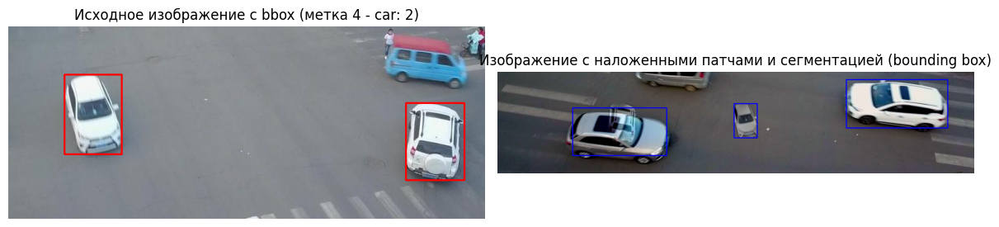




Predicted car at [148, 1, 340, 215], Hu moments: [ 1.83074401e-03  8.70150732e-07  3.04929589e-09  6.73718025e-10
  5.41152792e-19  1.49467284e-13 -7.99763677e-19]


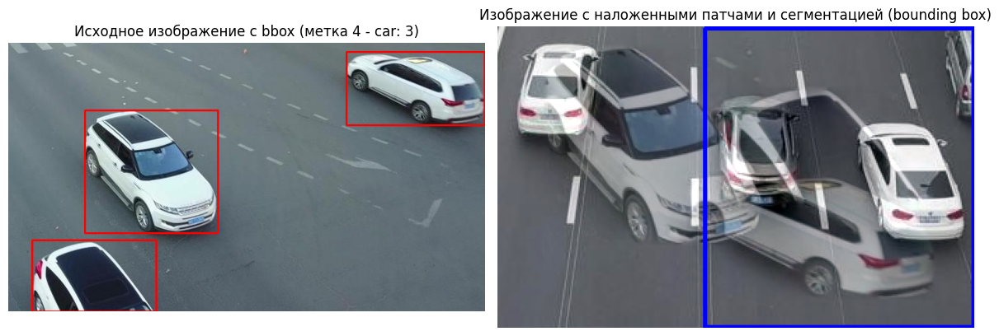




Predicted car at [214, 118, 482, 239], Hu moments: [9.80621669e-04 5.39456509e-07 8.68443627e-12 2.10151780e-12
 7.70475056e-24 1.17501570e-15 4.60845925e-24]
Predicted car at [643, 74, 692, 119], Hu moments: [ 6.51490903e-04  1.41834042e-08  1.94202430e-12  2.19218540e-14
  4.24947488e-27  2.39526877e-18 -1.54953614e-27]
Predicted car at [994, 24, 1288, 161], Hu moments: [ 9.40740195e-04  4.64267434e-07  9.97583680e-12  1.39467616e-12
  5.19517808e-24  9.49893517e-16 -2.69669127e-25]


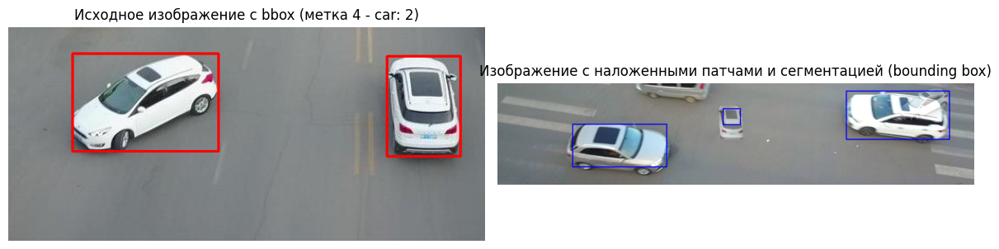




Predicted car at [364, 137, 440, 186], Hu moments: [7.58320162e-04 1.29642765e-07 9.46046046e-12 1.19974105e-12
 2.70046037e-24 4.01639502e-16 3.00742558e-24]
Predicted car at [442, 36, 521, 140], Hu moments: [ 6.92544530e-04  6.81206075e-08  3.80408413e-12  5.96704822e-14
 -1.54785918e-26 -3.89845476e-18 -2.38459984e-26]
Predicted car at [75, 34, 241, 142], Hu moments: [ 1.19728997e-03  7.81262833e-07  2.34345674e-10  1.28264395e-10
  2.20396147e-20  1.13093985e-13 -2.96067967e-21]


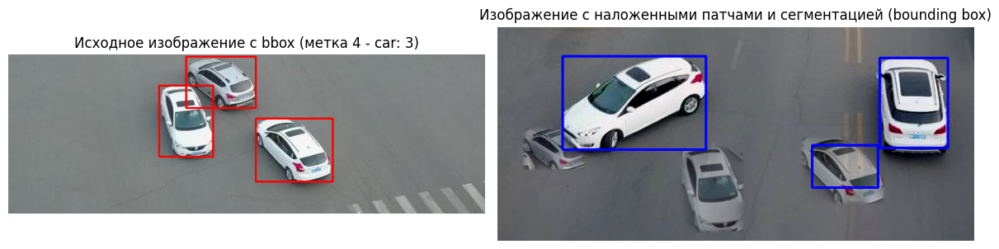




Predicted car at [40, 312, 222, 418], Hu moments: [ 7.42432118e-04  1.01291708e-07  8.47722571e-11  7.31239002e-12
  1.13079139e-22  8.88787464e-16 -1.42685524e-22]
Predicted car at [528, 20, 741, 121], Hu moments: [ 1.08696977e-03  6.53988790e-07  5.78238108e-11  3.25828245e-12
 -4.05792752e-23 -2.61574485e-15 -1.88021279e-23]


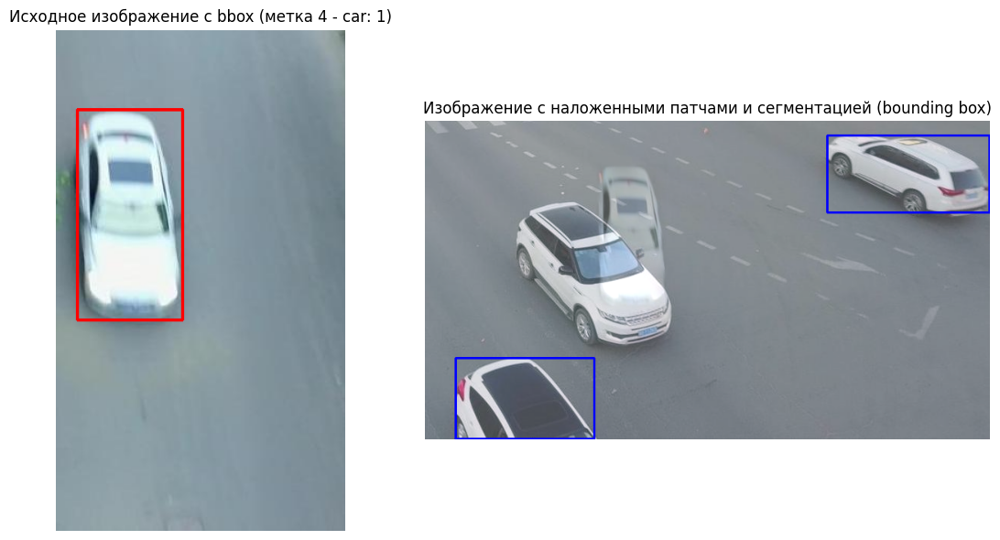




Predicted car at [358, 199, 569, 312], Hu moments: [9.70904475e-04 4.88755611e-07 3.47318929e-11 6.32345688e-12
 6.57233703e-23 3.18143779e-15 6.68012904e-23]
Predicted car at [94, 81, 183, 207], Hu moments: [ 7.47062510e-04  1.51579176e-07  8.34579899e-12  6.03441114e-13
  1.18242996e-24  1.99634435e-16 -6.60111010e-25]


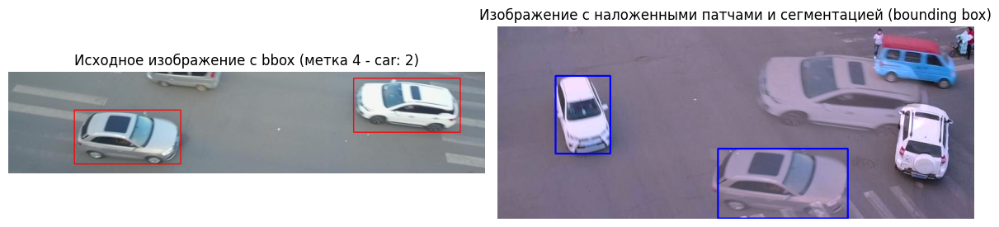




Predicted car at [382, 149, 441, 176], Hu moments: [ 9.16134667e-04  4.04842370e-07  1.39958816e-12  1.84617543e-13
 -6.75296374e-26 -4.88360289e-17 -6.51657032e-26]
Predicted car at [139, 93, 247, 250], Hu moments: [ 8.35852396e-04  2.59916599e-07  4.37520891e-11  9.81703762e-12
  2.03286760e-22  4.96390497e-15 -8.29197109e-24]


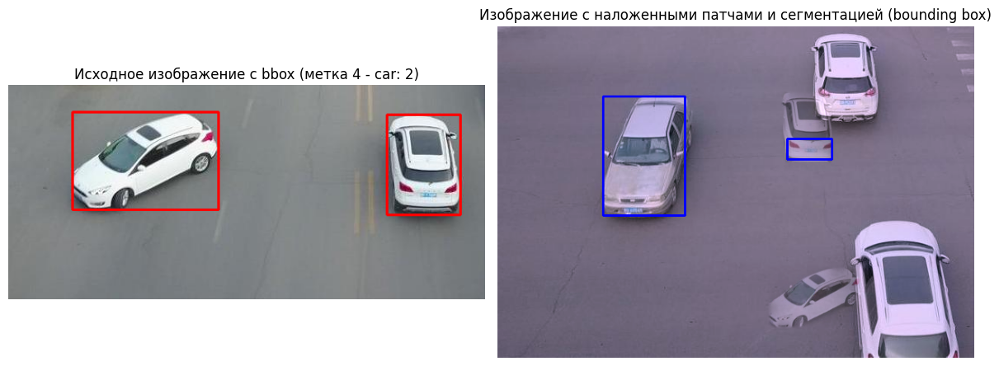




Mean accuracy: 0.828309518890691
Mean precision: 0.8691264949138681
Mean MSE: 9.8


In [ ]:
from __future__ import annotations

import numpy as np
import cv2
import copy
import os
import random
import torch
from torch.utils.data import Dataset, DataLoader
import matplotlib.pyplot as plt
from sklearn.neighbors import KNeighborsClassifier
from skimage.measure import label
from sklearn.preprocessing import StandardScaler

class ChessBoardWildFashionDataset(Dataset):
    def __init__(
        self,
        dataset_size: int,
        visdrone_images_path: str,
        visdrone_annotations_path: str,
        overlay_patches: bool = True
    ):
        self.dataset_size = dataset_size
        self.images_path = visdrone_images_path
        self.annotations_path = visdrone_annotations_path
        self.overlay_patches = overlay_patches
        self.image_files = [f for f in os.listdir(self.images_path) if f.endswith(".jpg")]
        self.annotation_files = [f.replace(".jpg", ".txt") for f in self.image_files]
        self.all_images = self.image_files.copy()
        random.shuffle(self.all_images)
        self.train_images = self.all_images[:10]
        self.knn, self.scaler = self.collect_training_data()
        self.used_combinations = []
        self.current_idx = 0

    def __len__(self):
        return self.dataset_size

    def calculate_iou(self, box1, box2):
        x1, y1, x2, y2 = box1
        x3, y3, x4, y4 = box2
        xi1, yi1 = max(x1, x3), max(y1, y3)
        xi2, yi2 = min(x2, x4), min(y2, y4)
        inter_area = max(0, xi2 - xi1) * max(0, yi2 - yi1)
        box1_area = (x2 - x1) * (y2 - y1)
        box2_area = (x4 - x3) * (y4 - y3)
        union_area = box1_area + box2_area - inter_area
        return inter_area / union_area if union_area > 0 else 0

    def load_image(self, filename):
        return cv2.cvtColor(cv2.imread(os.path.join(self.images_path, filename)), cv2.COLOR_BGR2RGB)

    def load_annotations(self, filename):
        bboxes = []
        with open(os.path.join(self.annotations_path, filename), 'r') as f:
            for line in f.readlines():
                values = list(map(int, line.strip().split(',')))
                x, y, w, h, _, category = values[:6]
                if category == 4:
                    bboxes.append((x, y, x + w, y + h))
        return bboxes

    def load_all_bboxes(self, filename):
        bboxes = []
        with open(os.path.join(self.annotations_path, filename), 'r') as f:
            for line in f.readlines():
                values = list(map(int, line.strip().split(',')))
                if len(values) >= 7:
                    category = values[2]
                    x = values[3]
                    y = values[4]
                    w = values[5]
                    h = values[6]
                    bboxes.append((x, y, w, h, category))
        return bboxes

    def collect_training_data(self):
        image_files = [f for f in os.listdir(self.images_path) if f.endswith('.jpg')]
        all_training_data = []
        all_labels = []

        for image_file in image_files:
            image_path = os.path.join(self.images_path, image_file)
            annotation_file = image_file.replace('.jpg', '.txt')
            annotation_path = os.path.join(self.annotations_path, annotation_file)

            coins = cv2.imread(image_path)
            coins = cv2.medianBlur(coins, 1)
            gray = cv2.cvtColor(coins, cv2.COLOR_BGR2GRAY)
            ret, thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)

            kernel = np.ones((3, 3), np.uint8)
            opening = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel, iterations=3)
            sure_bg = cv2.dilate(opening, kernel, iterations=5)

            dist_transform = cv2.distanceTransform(opening, cv2.DIST_L2, 5)
            ret, sure_fg = cv2.threshold(dist_transform, 0.8 * dist_transform.max(), 255, 0)
            sure_fg = np.uint8(sure_fg)
            unknown = cv2.subtract(sure_bg, sure_fg)

            ret, markers = cv2.connectedComponents(sure_fg)
            markers = markers + 1
            markers[unknown == 255] = 0
            markers = cv2.watershed(coins, markers)

            contours, hierarchy = cv2.findContours(markers.copy(), cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)

            annotations = []
            with open(annotation_path, 'r') as f:
                for line in f:
                    parts = line.strip().split(',')
                    x_min, y_min, width, height, _, class_id = map(int, parts[:6])
                    if class_id == 4:
                        annotations.append([x_min, y_min, x_min + width, y_min + height])

            training_data = []
            labels = []
            for i in range(len(contours)):
                if hierarchy[0][i][3] == -1:
                    mask = np.zeros_like(gray, dtype=np.uint8)
                    cv2.drawContours(mask, contours, i, 255, -1)
                    moments = cv2.moments(mask)
                    hu_moments = cv2.HuMoments(moments).flatten()
                    x, y, w, h = cv2.boundingRect(contours[i])
                    region_bbox = [x, y, x + w, y + h]
                    is_car = any(self.calculate_iou(region_bbox, annot_bbox) > 0.5 for annot_bbox in annotations)
                    training_data.append(hu_moments)
                    labels.append(1 if is_car else 0)

            all_training_data.extend(training_data)
            all_labels.extend(labels)

        all_training_data = np.array(all_training_data)
        all_labels = np.array(all_labels)

        scaler = StandardScaler()
        all_training_data = scaler.fit_transform(all_training_data)

        knn = KNeighborsClassifier(n_neighbors=1, metric='euclidean')
        knn.fit(all_training_data, all_labels)
        return knn, scaler

    def compute_color_statistics(self, image):
        mean, std = cv2.meanStdDev(image)
        return mean.flatten(), std.flatten()

    def apply_color_correction(self, src, ref):
        src_mean, src_std = self.compute_color_statistics(src)
        ref_mean, ref_std = self.compute_color_statistics(ref)
        adjusted = ((src - src_mean) * (ref_std / src_std)) + ref_mean
        return np.clip(adjusted, 0, 255).astype(np.uint8)

    def preprocess_images(self, bg, objects):
        ref_image_file = random.choice(self.image_files)
        ref_image = self.load_image(ref_image_file)
        bg = self.apply_color_correction(bg, ref_image)
        objects = [(self.apply_color_correction(obj, ref_image), (x2 - x1, y2 - y1)) for obj, (x1, y1, x2, y2) in objects]
        return bg, objects

    def bbox_area(self, bbox):
        x1, y1, x2, y2 = bbox
        return (x2 - x1) * (y2 - y1)

    def intersection_area(self, box1, box2):
        x1, y1, x2, y2 = box1
        x1_p, y1_p, x2_p, y2_p = box2
        xi1 = max(x1, x1_p)
        yi1 = max(y1, y1_p)
        xi2 = min(x2, x2_p)
        yi2 = min(y2, y2_p)
        return max(0, xi2 - xi1) * max(0, yi2 - yi1)

    def place_objects(self, bg, objects, max_overlap=0.5):
        h, w, _ = bg.shape
        placed_objects = []
        for obj, (ow, oh) in objects:
            scale = random.uniform(0.7, 1)
            obj_resized = cv2.resize(obj, (int(ow * scale), int(oh * scale)))
            oh, ow, _ = obj_resized.shape
            placed = False
            for _ in range(50):
                x, y = random.randint(0, w - ow), random.randint(0, h - oh)
                new_bbox = (x, y, x + ow, y + oh)
                if all(self.intersection_area(new_bbox, placed_bbox) < max_overlap * self.bbox_area(new_bbox) and self.intersection_area(new_bbox, placed_bbox) < max_overlap * self.bbox_area(placed_bbox) for placed_bbox in placed_objects):
                    mask = 255 * np.ones(obj_resized.shape, obj_resized.dtype)
                    center = (x + ow // 2, y + oh // 2)
                    try:
                        bg = cv2.seamlessClone(obj_resized, bg, mask, center, cv2.MIXED_CLONE)
                        placed_objects.append(new_bbox)
                        placed = True
                        break
                    except cv2.error as e:
                        print(f"Ошибка при вставке объекта: {e}")
            if not placed:
                print("Не удалось разместить объект без превышения 50% перекрытия.")
        return bg, placed_objects

    def segment_image(self, image):
        image = cv2.medianBlur(image, 1)
        gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
        ret, thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)

        kernel = np.ones((3,3), np.uint8)
        opening = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel, iterations=3)

        sure_bg = cv2.dilate(opening, kernel, iterations=5)

        dist_transform = cv2.distanceTransform(opening, cv2.DIST_L2, 5)
        ret, sure_fg = cv2.threshold(dist_transform, 0.8 * dist_transform.max(), 255, 0)
        sure_fg = np.uint8(sure_fg)
        unknown = cv2.subtract(sure_bg, sure_fg)

        ret, markers = cv2.connectedComponents(sure_fg)
        markers = markers + 1
        markers[unknown == 255] = 0
        markers = cv2.watershed(image, markers)
        return markers

    def __getitem__(self, idx):
        if self.current_idx >= self.dataset_size:
            self.used_combinations = []
            self.current_idx = 0
        self.current_idx += 1

        while True:
            patch_source_file = random.choice(self.image_files)
            annotation_file = patch_source_file.replace(".jpg", ".txt")
            bboxes = self.load_annotations(annotation_file)
            if len(bboxes) > 0:
                break

        while True:
            bg_file = random.choice(self.image_files)
            if bg_file != patch_source_file and (patch_source_file, bg_file) not in self.used_combinations:
                self.used_combinations.append((patch_source_file, bg_file))
                break

        bg_annotation_file = bg_file.replace(".jpg", ".txt")
        bg_bboxes = self.load_annotations(bg_annotation_file)
        bg_bboxes_tensor = torch.tensor(bg_bboxes, dtype=torch.int32)

        patch_source = self.load_image(patch_source_file)
        background = self.load_image(bg_file)

        if self.overlay_patches:
            objects = [(patch_source[y1:y2, x1:x2], (x1, y1, x2, y2)) for x1, y1, x2, y2 in bboxes]
            background, objects = self.preprocess_images(background, objects)
            final_image, placed_objects = self.place_objects(background, objects)
            new_bboxes = torch.tensor(placed_objects, dtype=torch.int32)
        else:
            final_image = background
            new_bboxes = torch.empty((0, 4), dtype=torch.int32)

        markers = self.segment_image(final_image)

        contours, hierarchy = cv2.findContours(markers.copy(), cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)

        test_data = []
        bboxes_pred = []
        original_hu_moments = []
        for i in range(len(contours)):
            if hierarchy[0][i][3] == -1:
                mask = np.zeros_like(markers, dtype=np.uint8)
                cv2.drawContours(mask, contours, i, 255, -1)
                moments = cv2.moments(mask)
                hu_moments = cv2.HuMoments(moments).flatten()
                x, y, w, h = cv2.boundingRect(contours[i])
                if w > 10 and h > 10 and w < 300 and h < 1000: # and 0.5 < w / h < 4.0:
                    original_hu_moments.append(hu_moments)
                    test_data.append(hu_moments)
                    bboxes_pred.append([x, y, x+w, y+h])

        test_data = np.array(test_data)
        if len(test_data) > 0:
            test_data = self.scaler.transform(test_data)
            predictions = self.knn.predict(test_data)
        else:
            predictions = np.array([])

        car_bboxes = [bbox for pred, bbox in zip(predictions, bboxes_pred) if pred == 1]
        if len(car_bboxes) > 0:
            boxes = np.array(car_bboxes)
            scores = np.ones(len(car_bboxes))
            indices = cv2.dnn.NMSBoxes(boxes.tolist(), scores.tolist(), score_threshold=0.5, nms_threshold=0.5)
            filtered_bboxes = [car_bboxes[i] for i in indices]
        else:
            filtered_bboxes = []

        pred_mask = np.zeros(final_image.shape[:2], dtype=np.uint8)
        for bbox in filtered_bboxes:
            x1, y1, x2, y2 = bbox
            print(f"Predicted car at [{x1}, {y1}, {x2}, {y2}], Hu moments: {original_hu_moments[bboxes_pred.index(bbox)]}")
            pred_mask[y1:y2, x1:x2] = 255

        return torch.FloatTensor(patch_source), torch.tensor(bboxes, dtype=torch.int32), torch.FloatTensor(final_image), \
               new_bboxes, len(bboxes), torch.FloatTensor(pred_mask), bg_bboxes_tensor

if __name__ == "__main__":
    dataset = ChessBoardWildFashionDataset(
        dataset_size=10,
        visdrone_images_path="/content/newimages",
        visdrone_annotations_path="/content/newannotations",
        overlay_patches = True
    )
    dataloader = DataLoader(dataset, batch_size=1, shuffle=True)

    accuracies = []
    precisions = []
    mse_counts = []

    for patch_img_tensor, bboxes, final_img_tensor, new_bboxes, num_objects, pred_mask_tensor, bg_bboxes_tensor in dataloader:
        patch_img = patch_img_tensor[0].numpy().astype(np.uint8)
        final_img = final_img_tensor[0].numpy().astype(np.uint8)
        pred_mask = pred_mask_tensor[0].numpy().astype(np.uint8)
        new_bboxes_np = new_bboxes[0].numpy()
        bg_bboxes_np = bg_bboxes_tensor[0].numpy()

        h, w, _ = final_img.shape
        gt_mask = np.zeros((h, w), dtype=np.uint8)
        for bbox in np.vstack((bg_bboxes_np, new_bboxes_np)):
            x1, y1, x2, y2 = map(int, bbox)
            gt_mask[y1:y2, x1:x2] = 255

        total_pixels = h * w
        tp = np.sum((gt_mask == 255) & (pred_mask == 255))
        tn = np.sum((gt_mask == 0) & (pred_mask == 0))
        fp = np.sum((gt_mask == 0) & (pred_mask == 255))
        fn = np.sum((gt_mask == 255) & (pred_mask == 0))
        accuracy = (tp + tn) / total_pixels if total_pixels > 0 else 0
        precision = tp / (tp + fp) if (tp + fp) > 0 else 0

        num_gt_cars = len(bg_bboxes_np) + len(new_bboxes_np)
        labeled_pred = label(pred_mask)
        num_pred_cars = len(np.unique(labeled_pred)) - 1
        mse_count = (num_gt_cars - num_pred_cars) ** 2

        accuracies.append(accuracy)
        precisions.append(precision)
        mse_counts.append(mse_count)

        if dataset.overlay_patches:
            plt.figure(figsize=(12, 6))
            plt.subplot(1, 2, 1)
            for x1, y1, x2, y2 in bboxes[0].numpy():
                cv2.rectangle(patch_img, (x1, y1), (x2, y2), (255, 0, 0), 2)
            plt.imshow(patch_img)
            plt.title(f'Исходное изображение с bbox (метка 4 - car: {num_objects.item()})')
            plt.axis('off')

            plt.subplot(1, 2, 2)
            final_img_with_bboxes = final_img.copy()
            contours, _ = cv2.findContours(pred_mask.astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            for contour in contours:
                x, y, w, h = cv2.boundingRect(contour)
                cv2.rectangle(final_img_with_bboxes, (x, y), (x + w, y + h), (0, 0, 255), 2)
            plt.imshow(final_img_with_bboxes)
            plt.title('Изображение с наложенными патчами и сегментацией (bounding box)')
            plt.axis('off')

            plt.tight_layout()
            plt.show()
            print('\n\n')
        else:
            plt.figure(figsize=(6, 6))
            final_img_with_bboxes = final_img.copy()
            contours, _ = cv2.findContours(pred_mask.astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            for contour in contours:
                x, y, w, h = cv2.boundingRect(contour)
                cv2.rectangle(final_img_with_bboxes, (x, y), (x + w, y + h), (0, 0, 255), 2)
            plt.imshow(final_img_with_bboxes)
            plt.title('Изображение с сегментацией (bounding box)')
            plt.axis('off')
            plt.show()
            print('\n\n')

    avg_accuracy = np.mean(accuracies)
    avg_precision = np.mean(precisions)
    avg_mse_count = np.mean(mse_counts)
    print(f"Mean accuracy: {avg_accuracy}")
    print(f"Mean precision: {avg_precision}")
    print(f"Mean MSE: {avg_mse_count}")